## Import libraries

In [2]:
import pandas as pd
import numpy as np
import seaborn as sns

## Read Data

In [51]:
# using dataset without imputations
df = pd.read_csv('data/Dementia_ISRID2_Hanna_2017_Clean_For_R_v2_Dec8_edited.csv', encoding = "ISO-8859-1", index_col=0)

## Inspect Data

In [52]:
df.head()

,Data Source,Country,State/Province/Region,Incident Type,Incident Date Time,Incident Year,Incident Month,Incident Day,Time,City,...,Find Accuracy,Disperson Angle (remove),Mission Close (remove),Rescue Method,Resources Used,Total Air Hours,Total Personnel,Total Man Hours,Total Cost,Comments
Incident #,,,,,,,,,,,,,,,,,,,,,
1,PLI,US,VA,NaN,7/28/2004,2004.0,7.0,28.0,NaN,Chesapeake,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,AU,AU,NaN,Recovery,9/30/2000,2000.0,9.0,30.0,NaN,Port Broughton,...,NaN,NaN,Found,NaN,NaN,NaN,NaN,NaN,NaN,"71 year old male suffering Alzheimers, canoein..."
3,AU,AU,NaN,Search,1/7/2000,2000.0,1.0,7.0,NaN,Jondaryan,...,NaN,NaN,Found,NaN,NaN,NaN,NaN,NaN,NaN,Left at 0630 to drive 14km to Jondaryan. Drov...
4,AU,AU,NaN,Search,11/15/2001,2001.0,11.0,15.0,NaN,Ballarat,...,NaN,NaN,Found,NaN,NaN,NaN,NaN,23.0,NaN,"Descp broadcast to taxis, trucks, etc. MP loca..."
5,AU,AU,NaN,Search,10/9/2000,2000.0,10.0,9.0,NaN,Ballarat,...,NaN,NaN,Found,NaN,NaN,NaN,NaN,15.0,NaN,"88 year old male suffering dementia, wandered ..."


In [53]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 3275 entries, 1 to 3276
Data columns (total 68 columns):
 #   Column                              Non-Null Count  Dtype  
---  ------                              --------------  -----  
 0   Data Source                         3275 non-null   object 
 1   Country                             3275 non-null   object 
 2   State/Province/Region               2452 non-null   object 
 3   Incident Type                       2001 non-null   object 
 4   Incident Date Time                  2473 non-null   object 
 5   Incident Year                       2473 non-null   float64
 6   Incident Month                      2473 non-null   float64
 7   Incident Day                        2473 non-null   float64
 8   Time                                15 non-null     object 
 9   City                                1837 non-null   object 
 10  County                              2798 non-null   object 
 11  EcoRegion Domain                    3274 no

Dataset is very sparse

In [66]:
df[~df['IPP Coord. '].isna()]['IPP Coord. ']

Incident #
4          VicRoads 254 D11
5                 Map 16 F3
6          8125 04370 59757
18                  205 H10
19                 GR871211
               ...         
3255    42.44672, -78.89963
3261       1801815, 5587520
3262       1886203, 5785235
3263       1325600, 4995700
3274                953/774
Name: IPP Coord. , Length: 700, dtype: object

In [54]:
df.describe()

,Incident Year,Incident Month,Incident Day,# Lost,Age,Weight (Kg),Height (Cm),Temp L,Distance IPP (km),Distance Destination (km) (remove),Distance IPP (miles) (remove),Track Offset (m),Disperson Angle (remove),Total Air Hours,Total Personnel,Total Man Hours,Total Cost
count,2473.000000,2473.000000,2473.000000,2857.000000,2466.000000,71.000000,81.000000,148.000000,2392.000000,1.000000,1810.000000,1174.000000,2.000000,395.000000,735.000000,1004.000000,847.000000
mean,2004.363122,6.669228,15.124949,1.001750,75.667478,67.019846,169.503210,11.725946,3.080007,7.003134,1.924398,101.164842,82.505069,0.319494,16.963265,76.428328,949.119847
std,12.796103,3.239960,8.718039,0.056109,10.234875,18.351825,10.000446,10.642235,9.592976,NaN,6.572008,537.606970,100.309998,1.406511,71.812654,319.380167,3436.290867
min,1904.000000,1.000000,1.000000,0.000000,16.000000,0.000000,144.780000,-9.444444,0.000000,7.003134,0.000000,0.000000,11.575189,0.000000,0.000000,0.000000,0.000000
25%,2003.000000,4.000000,8.000000,1.000000,71.000000,57.954545,165.000000,3.000000,0.396241,7.003134,0.246212,0.000000,47.040129,0.000000,4.000000,4.000000,11.505000
50%,2006.000000,7.000000,15.000000,1.000000,78.000000,65.000000,170.000000,10.000000,1.000000,7.003134,0.568182,4.572056,82.505069,0.000000,7.000000,12.000000,208.250000
75%,2010.000000,9.000000,22.000000,1.000000,82.000000,76.136364,175.260000,18.000000,3.006828,7.003134,1.860000,30.480371,117.970009,0.000000,15.000000,38.700000,721.437500
max,2014.000000,12.000000,31.000000,2.000000,98.000000,140.000000,200.000000,38.000000,316.895072,7.003134,196.909091,12874.908560,153.434949,20.000000,1857.000000,6600.000000,74997.999000


From here we can see the <br>
average age is 75.6 out of 2466 records <br>
average IPP Distance is 3.08 km out of 2392 records <br>
average total air hours is 0.32 out of 395 records <br>
average total personnel is 17 out of 735 records <br>
average total man hours is 76.4 out of 1004 records <br>
average total cost is 949.2 out of 847 records

In [55]:
df.describe(include='object')

,Data Source,Country,State/Province/Region,Incident Type,Incident Date Time,Time,City,County,EcoRegion Domain,Population Density,...,Subject Found feature,Found Secondary (remove),Mobility Responsiveness (remove),Lost Strategy,Find Coord,Find Accuracy,Mission Close (remove),Rescue Method,Resources Used,Comments
count,3275,3275,2452,2001,2473,15,1837,2798,3274,1130,...,1700,212,144,444,446,268,160,109,21,954
unique,35,7,50,3,1792,14,529,311,4,5,...,59,84,10,107,434,262,5,18,9,870
top,PLI,US,VA,Search,7/5/1905,8:00,Norfolk,VA,Temperate,Urban,...,Residence,None/Grass,Mobile,Random wandering,0,0,Found,Assist/own power,Police Officers.,[See report for details.]
freq,940,2177,986,1984,27,2,182,842,3100,511,...,488,25,93,103,3,3,149,46,9,51


In [57]:
df.loc[df['Distance IPP (km)'] == df['Distance IPP (km)'].max()] # record with max ipp distance

,Data Source,Country,State/Province/Region,Incident Type,Incident Date Time,Incident Year,Incident Month,Incident Day,Time,City,...,Find Accuracy,Disperson Angle (remove),Mission Close (remove),Rescue Method,Resources Used,Total Air Hours,Total Personnel,Total Man Hours,Total Cost,Comments
Incident #,,,,,,,,,,,,,,,,,,,,,
1813,PLI,US,VA,NaN,9/4/2004,2004.0,9.0,4.0,NaN,Botetourt,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [59]:
df.loc[df['Total Man Hours'] == df['Total Man Hours'].max()] # record with max total man hours

,Data Source,Country,State/Province/Region,Incident Type,Incident Date Time,Incident Year,Incident Month,Incident Day,Time,City,...,Find Accuracy,Disperson Angle (remove),Mission Close (remove),Rescue Method,Resources Used,Total Air Hours,Total Personnel,Total Man Hours,Total Cost,Comments
Incident #,,,,,,,,,,,,,,,,,,,,,
587,US-PA,US,PA,Search,4/2/1985,1985.0,4.0,2.0,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,216.0,6600.0,NaN,NORTHEAST SAR COORD


In [60]:
df.loc[df['Total Cost'] == df['Total Cost'].max()] # record with max cost

,Data Source,Country,State/Province/Region,Incident Type,Incident Date Time,Incident Year,Incident Month,Incident Day,Time,City,...,Find Accuracy,Disperson Angle (remove),Mission Close (remove),Rescue Method,Resources Used,Total Air Hours,Total Personnel,Total Man Hours,Total Cost,Comments
Incident #,,,,,,,,,,,,,,,,,,,,,
2933,NZ,NZ,NaN,Search,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,68.0,1794.4,74997.999,NaN


## Plotting distributions and relationships

<AxesSubplot:xlabel='Age', ylabel='TTL Hours'>

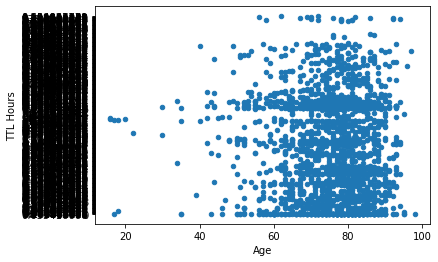

In [62]:
df[['Age','TTL Hours']].plot.scatter(x='Age',y='TTL Hours')

<AxesSubplot:>

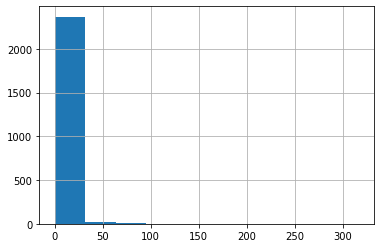

In [63]:
df['Distance IPP (km)'].hist()

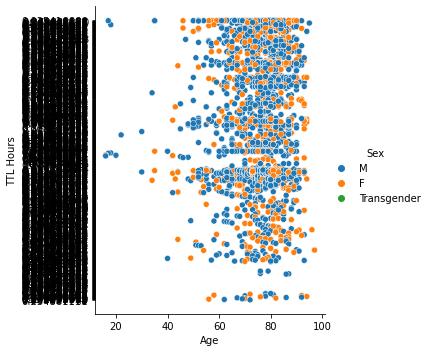

In [64]:
sns.relplot(data=df, x='Age', y='TTL Hours', hue='Sex')

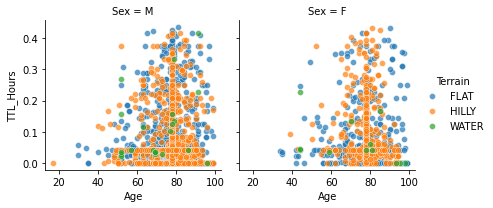

In [27]:
g = sns.FacetGrid(df, col="Sex", hue="Terrain")
g.map(sns.scatterplot, "Age", "TTL Hours", alpha=.7)
g.add_legend()

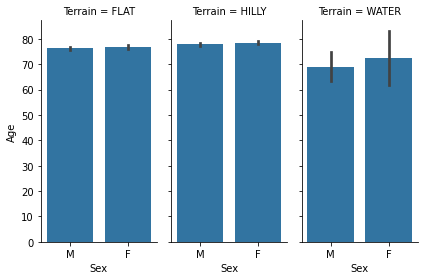

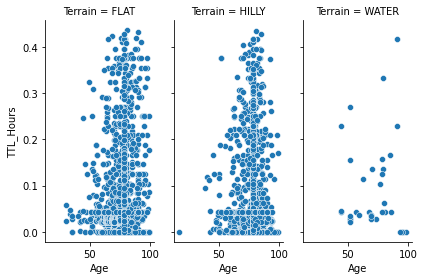

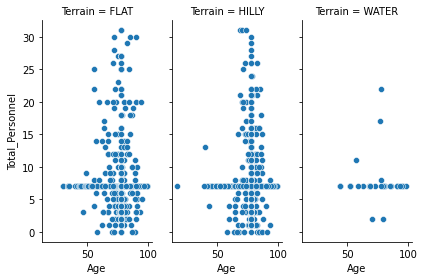

In [34]:
g = sns.FacetGrid(df, col="Terrain", height=4, aspect=.5)
g.map(sns.barplot, "Sex", "Age", order=["M", "F"])
g = sns.FacetGrid(df, col="Terrain", height=4, aspect=.5)
g.map(sns.scatterplot, "Age", "TTL_Hours")
g = sns.FacetGrid(df, col="Terrain", height=4, aspect=.5)
g.map(sns.scatterplot, "Age", "Total_Personnel")

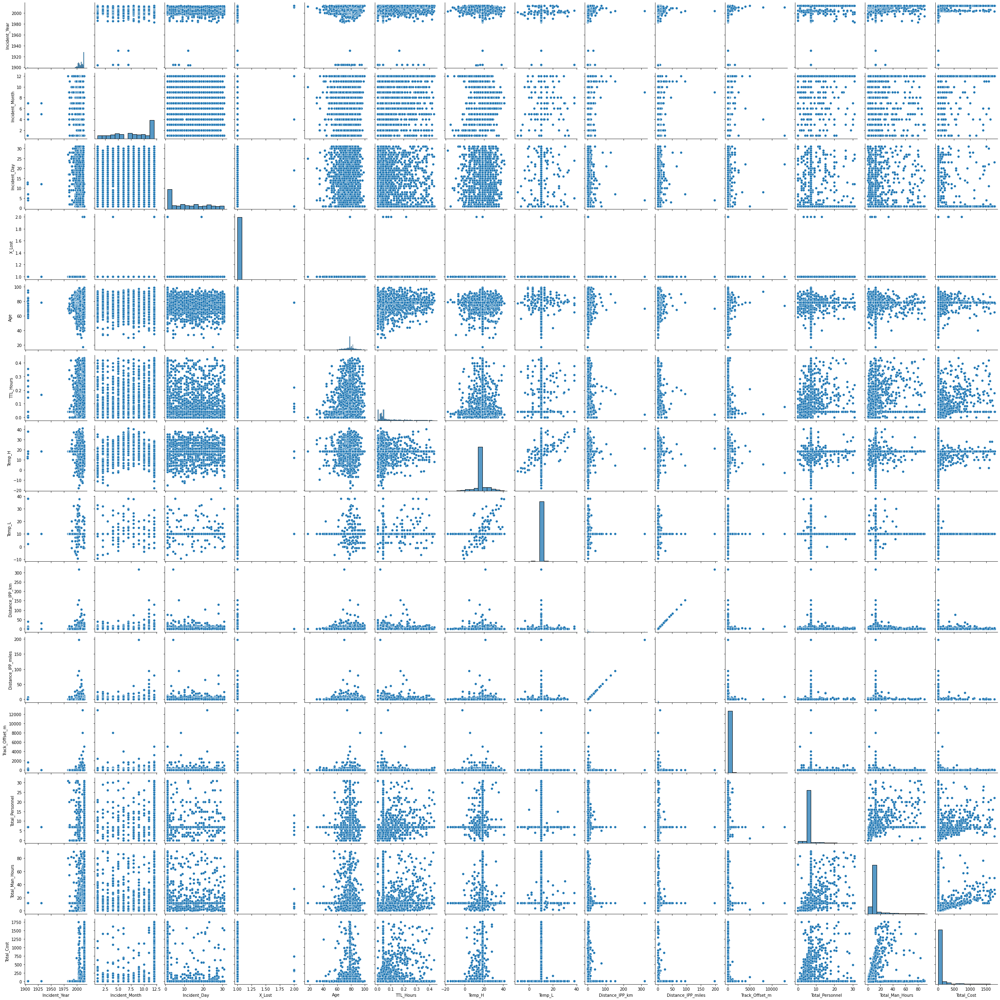

In [29]:
sns.pairplot(df.select_dtypes(['int','float']))

In [69]:
from pandas_profiling import ProfileReport
profile = ProfileReport(df, title="Pandas Profiling Report", explorative=True)

In [70]:
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [71]:
profile.to_notebook_iframe()

In [72]:
profile.to_file("ISRID_report.html")

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]